<a href="https://colab.research.google.com/github/aymanaboghonim/My_Projects/blob/main/Use_Case_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

 # <font color='red'>Problem Definition & Formulation</font>
 The problem formulation phase of the ML Pipeline is critical, and it’s where everything begins.It starts by seeing a problem and thinking “what question, if I could answer it, would provide the most value to my business?” 

Part of the problem formulation phase includes seeing where there are opportunities to use machine learning and consider the following questions:
1.	Is machine learning appropriate for this problem, and why or why not?
2.	What is the ML problem if there is one, and what would a success metric look like?
3.	What kind of ML problem is this?
4.	Is the data appropriate?



# Answers for the four mentioned questions!
To answer those question, I must understand the problem well and then explore the data to build and inution about it, then come up with rigoures arguments which lead to a conclusion and prespictives. 

1)	ML is appropriate because of the scale, variety and speed required. There are potentially many of Features and millions of Clients that need to be screened well nas this will let the stalkholders identify who will pay his default credit cart and who not will pay, and put a plan to manage this situation to minimize the risk and maximize the profit.

2)	The problem is : given historical data of a client, could we predict whether they will pay thier default credit card or not ?
i.	Success would be the total number of clients that were accurately predicted to not pay their default credit card. In this context, we should pay attention to minimize the risk through focusing on people who will not pay more than those who will pay. It is not always the case, however, we always will try to minimize the risk!

3)	This is a supervised binary classification ML problem because we have a labeled data point (Target) and we have only two outputs(Classes).

4)	This data is appropriate because it has variety of financial info that is related to the prediction of the ability to pay the default credit card and a lot of examples with  labeled target to train, tune and test the model .


# <font color='blue'>Importing Libraries and Modules </font>

As a common good practice, I will import all the Libraries and modules at the begining of the notebook


In [ ]:
# import essintial libraries 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
from scipy import stats

%matplotlib inline
# import model modules
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier

# import model evaluation modules
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import roc_curve

# <font color='blue'>Loading Data </font>

This dataset contains information on default payments, demographic factors, credit data, history of payment, and bill statements of credit card clients. 

## Content

There are 25 variables:

* **ID**: ID of each client
* **LIMIT_BAL**: Amount of given credit in NT dollars (includes individual and family/supplementary credit
* **SEX**: Gender (1=male, 2=female)
* **EDUCATION**: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
* **MARRIAGE**: Marital status (1=married, 2=single, 3=others)
* **AGE**: Age in years
* **PAY_0**: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, ... 8=payment delay for eight months, 9=payment delay for nine months and above)
* **PAY_2**: Repayment status in August, 2005 (scale same as above)
* **PAY_3**: Repayment status in July, 2005 (scale same as above)
* **PAY_4**: Repayment status in June, 2005 (scale same as above)
* **PAY_5**: Repayment status in May, 2005 (scale same as above)
* **PAY_6**: Repayment status in April, 2005 (scale same as above)
* **BILL_AMT1**: Amount of bill statement in September, 2005 (NT dollar)
* **BILL_AMT2**: Amount of bill statement in August, 2005 (NT dollar)
* **BILL_AMT3**: Amount of bill statement in July, 2005 (NT dollar)
* **BILL_AMT4**: Amount of bill statement in June, 2005 (NT dollar)
* **BILL_AMT5**: Amount of bill statement in May, 2005 (NT dollar)
* **BILL_AMT6**: Amount of bill statement in April, 2005 (NT dollar)
* **PAY_AMT1**: Amount of previous payment in September, 2005 (NT dollar)
* **PAY_AMT2**: Amount of previous payment in August, 2005 (NT dollar)
* **PAY_AMT3**: Amount of previous payment in July, 2005 (NT dollar)
* **PAY_AMT4**: Amount of previous payment in June, 2005 (NT dollar)
* **PAY_AMT5**: Amount of previous payment in May, 2005 (NT dollar)
* **PAY_AMT6**: Amount of previous payment in April, 2005 (NT dollar)
* **default.payment.next.month**: Default payment (1=yes, 0=no)



In [ ]:
#Using read_excel method to read the excel file
data = pd.read_excel("https://storage.googleapis.com/mcit_use_cas1/default%20of%20credit%20card%20clients.xls", skiprows=1)

In [ ]:
#Check that our data was loaded successfully
data.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,female,university,married,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
1,2,120000,female,university,single,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,female,university,single,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,female,university,married,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,male,university,married,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0


# <font color='red'>  EDA </font>

# EDA is crucial step that help us explore and understand our data to build an intution  about it, and outline the required preprocessing steps before the modeling stage. 

In [ ]:
# Using Pandas Profiling for automated EDA
EDA_Report = ProfileReport(data)
EDA_Report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/39 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### the EDA_Report show us see some statics about our data, variable types, missing Values and so on. It help us to define :-

* Preprocessing required such as Encoding non-numerical data, Scaling and normalization required, and Imputing missed data.
* Dropped Useless Features that do not add up any values such as IDs.
* The Target Class disrtibution to roll out the Balance between the two classes. in Our case, there is a significant imbalance between Classes!
* Further EDA steps to viualize the relation between features and Target.




0    23364
1     6636
Name: default payment next month, dtype: int64

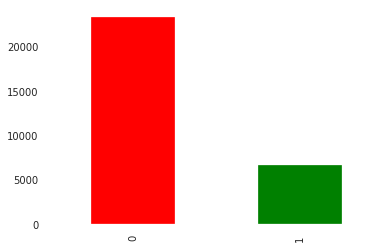

In [ ]:
# check the balance between the two classesof the target 
data["default payment next month"].value_counts().plot(kind="bar", color = ["red","green"]);
data["default payment next month"].value_counts()

### We have significant imbalance between the two classes, so we can not depend on the accuracy only as an evaluation metric. In addition, we may need to take further percautions to handle this signficant imbalance, but let us wait and see! 

## Removing Numerical Outliers 
Befor I will dive deep into EDA, I will set a threshold to remove the outliers from Data to recognize the pattern accuratelly and avoid misleading.
**Subjectivelly** I will define a function that remove outliers based on Z.scores.
> I found this function on Stack Over Flow website.

In [ ]:
#lets set our thresholds to filter out our Data from Outliers.

def drop_numerical_outliers(data, z_thresh=3):
    # Constrains will contain `True` or `False` depending on if it is a value below the threshold.
    constrains = data.select_dtypes(include=[np.number]) \
        .apply(lambda x: np.abs(stats.zscore(x)) < z_thresh) \
        .all(axis=1)
    # Drop (inplace) values set to be rejected
    data.drop(data.index[~constrains], inplace=True)

In [ ]:
drop_numerical_outliers(data)
data.head()


,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,female,university,married,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
1,2,120000,female,university,single,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,female,university,single,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,female,university,married,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
5,6,50000,male,graduate school,single,37,0,0,0,0,0,0,64400,57069,57608,19394,19619,20024,2500,1815,657,1000,1000,800,0


## Bivariate Analysis of Our Target Versus some Selected Features

> **Target vs Age**

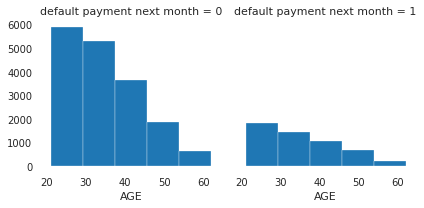

In [ ]:
g = sns.FacetGrid(data, col='default payment next month')
g.map(plt.hist, 'AGE', bins=5)


### It seems like that no obviuos relation between our Target and AGE !

> **Target vs Limit Balance**

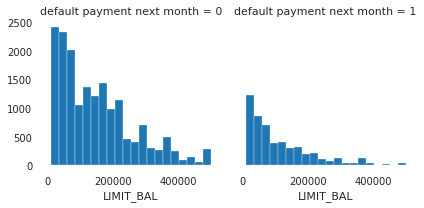

In [ ]:
g = sns.FacetGrid(data, col='default payment next month')
g.map(plt.hist, 'LIMIT_BAL', bins=20)


###  It seems like that there is some non_linear relationship (weak correlation ) between limit balance and Target.

> **Target Vs Sex**

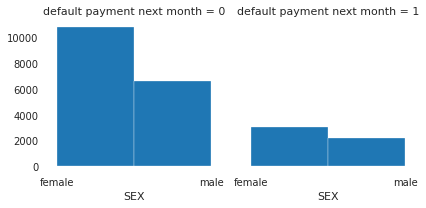

In [ ]:
g = sns.FacetGrid(data, col='default payment next month')
g.map(plt.hist, 'SEX', bins=2)


### It is interesting that paying the default credit card is Age & Sex & Limit-balance Agnostic! 

# Data Preparation.

To prepare our data we will do the following:
1. Replace Zeros with Nan 
2. Convert npn-numerical data into numerical type
3. Fill the missing Data with Median


In [ ]:
data = data.replace({'0':np.nan, 0:np.nan})
data.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1.0,20000.0,female,university,married,24.0,2.0,2.0,-1.0,-1.0,-2.0,-2.0,3913.0,3102.0,689.0,NaN,NaN,NaN,NaN,689.0,NaN,NaN,NaN,NaN,1.0
1,2.0,120000.0,female,university,single,26.0,-1.0,2.0,NaN,NaN,NaN,2.0,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,NaN,1000.0,1000.0,1000.0,NaN,2000.0,1.0
2,3.0,90000.0,female,university,single,34.0,NaN,NaN,NaN,NaN,NaN,NaN,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,NaN
3,4.0,50000.0,female,university,married,37.0,NaN,NaN,NaN,NaN,NaN,NaN,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,NaN
5,6.0,50000.0,male,graduate school,single,37.0,NaN,NaN,NaN,NaN,NaN,NaN,64400.0,57069.0,57608.0,19394.0,19619.0,20024.0,2500.0,1815.0,657.0,1000.0,1000.0,800.0,NaN


In [ ]:
# Fill numeric rows with the median
for label, content in data.items():
    if pd.api.types.is_numeric_dtype(content):
        if pd.isnull(content).sum():
            # Fill missing numeric values with median since it's more robust than the mean
            data[label] = content.fillna(content.median())

In [ ]:
# Turn categorical variables into numbers
for label, content in data.items():
    # Check columns which *aren't* numeric
    if not pd.api.types.is_numeric_dtype(content):
        # We add the +1 because pandas encodes missing categories as -1
        data[label] = pd.Categorical(content).codes+1

In [ ]:
# Check that we do not have missing values
data.isnull().sum()

ID                            0
LIMIT_BAL                     0
SEX                           0
EDUCATION                     0
MARRIAGE                      0
AGE                           0
PAY_0                         0
PAY_2                         0
PAY_3                         0
PAY_4                         0
PAY_5                         0
PAY_6                         0
BILL_AMT1                     0
BILL_AMT2                     0
BILL_AMT3                     0
BILL_AMT4                     0
BILL_AMT5                     0
BILL_AMT6                     0
PAY_AMT1                      0
PAY_AMT2                      0
PAY_AMT3                      0
PAY_AMT4                      0
PAY_AMT5                      0
PAY_AMT6                      0
default payment next month    0
dtype: int64

> Our data is ready for modiling, so lets move to the next step

# <font color='red'>  Modeling </font>

## Lets split our data first

In [ ]:
# Splitting data 
x = data.drop(["fbs","chol","target"], axis = 1) 
# I dropped the features with least correlation which can mislead the models, and also dropped the target value

y = data["target"]
np.random.seed(42) # random seed for reproduciblity of the result.
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2)